In [ ]:
%tensorflow_version 2.x
import tensorflow as tf
print("Tensorflow version " + tf.__version__)

try:
  tpu = tf.distribute.cluster_resolver.TPUClusterResolver()  # TPU detection
  print('Running on TPU ', tpu.cluster_spec().as_dict()['worker'])
except ValueError:
  raise BaseException('ERROR: Not connected to a TPU runtime; please see the previous cell in this notebook for instructions!')

tf.config.experimental_connect_to_cluster(tpu)
tf.tpu.experimental.initialize_tpu_system(tpu)
tpu_strategy = tf.distribute.experimental.TPUStrategy(tpu)

Tensorflow version 2.3.0
Running on TPU  ['10.58.161.26:8470']
INFO:tensorflow:Initializing the TPU system: grpc://10.58.161.26:8470


INFO:tensorflow:Initializing the TPU system: grpc://10.58.161.26:8470


INFO:tensorflow:Clearing out eager caches


INFO:tensorflow:Clearing out eager caches


INFO:tensorflow:Finished initializing TPU system.


INFO:tensorflow:Finished initializing TPU system.


INFO:tensorflow:Found TPU system:


INFO:tensorflow:Found TPU system:


INFO:tensorflow:*** Num TPU Cores: 8


INFO:tensorflow:*** Num TPU Cores: 8


INFO:tensorflow:*** Num TPU Workers: 1


INFO:tensorflow:*** Num TPU Workers: 1


INFO:tensorflow:*** Num TPU Cores Per Worker: 8


INFO:tensorflow:*** Num TPU Cores Per Worker: 8


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:XLA_CPU:0, XLA_CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:localhost/replica:0/task:0/device:XLA_CPU:0, XLA_CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:CPU:0, CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:0, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:0, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:1, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:1, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:2, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:2, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:3, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:3, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:4, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:4, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:5, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:5, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:6, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:6, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:7, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU:7, TPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU_SYSTEM:0, TPU_SYSTEM, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:TPU_SYSTEM:0, TPU_SYSTEM, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:XLA_CPU:0, XLA_CPU, 0, 0)


INFO:tensorflow:*** Available Device: _DeviceAttributes(/job:worker/replica:0/task:0/device:XLA_CPU:0, XLA_CPU, 0, 0)


#                 *Data Mining Project : Analysis Of Road Accidents In US* 

**Description**

This is a countrywide car accident dataset, which covers 49 states of the USA. The accident data are collected from February 2016 to June 2020, using two APIs that provide streaming traffic incident (or event) data. These APIs broadcast traffic data captured by a variety of entities, such as the US and state departments of transportation, law enforcement agencies, traffic cameras, and traffic sensors within the road-networks. Currently, there are about 3.5 million accident records in this dataset. Check here to learn more about this dataset.

**Content**

This dataset has been collected in real-time, using multiple Traffic APIs. Currently, it contains accident data that are collected from February 2016 to June 2020 for the Contiguous United States.

**Inspiration**

US-Accidents can be used for numerous applications such as real-time car accident prediction, studying car accidents hotspot locations, casualty analysis and extracting cause and effect rules to predict car accidents, and studying the impact of precipitation or other environmental stimuli on accident occurrence. The most recent release of the dataset can also be useful to study the impact of COVID-19 on traffic behavior and accidents.

**Applications of Dataset**

US-Accidents can be used for numerous applications such as real-time accident prediction, studying accident hotspot locations, casualty analysis and extracting cause and effect rules to predict accidents, or studying the impact of precipitation or other environmental stimuli on accident occurrence.

**Setting Up Google Drive**

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


**Attributes Information**

![picture](https://drive.google.com/uc?id=13nKZyU7k65yIMUeKt9wwu0rYv9eaQk_1)

# **Importing required packages**

In [ ]:
# Miscellaneous
import inspect
from sklearn.preprocessing import MinMaxScaler
import os

# To handle and analyze data
import pandas as pd

# To perform numeriacal operations 
import numpy as np

# For missing values
import missingno as msno 
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

# For outlier analysis
from sklearn.covariance import EllipticEnvelope

# For encoding
from sklearn.preprocessing import LabelEncoder

# For co-relation
!pip install mlens
from mlens.visualization import corrmat

# For visualization
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objects as go

import graphviz
from sklearn import tree

from sklearn.metrics import plot_confusion_matrix

# For splitting data
from sklearn.model_selection import train_test_split

# For metrics
from sklearn import preprocessing
from sklearn.model_selection import cross_val_score
from sklearn.metrics import accuracy_score, classification_report
from sklearn.metrics import confusion_matrix, roc_auc_score

!pip install pyclustertend
from pyclustertend import hopkins
!pip install kneed
from kneed import KneeLocator
from sklearn import metrics

# For classification
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier

from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier
import xgboost as xgb

from sklearn.linear_model import LogisticRegression
from mlxtend.classifier import StackingClassifier

# For Clustering
from sklearn.cluster import KMeans

     |████████████████████████████████| 235kB 4.9MB/s 


[MLENS] backend: threading


/usr/local/lib/python3.6/dist-packages/sklearn/externals/six.py:31: FutureWarning:

The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).



In [ ]:
!unrar x "/content/gdrive/MyDrive/Data Mining Project Files/US_Accidents_June20.rar" "/content"

data = pd.read_csv("/content/US_Accidents_June20.csv")

data.head()


UNRAR 5.50 freeware      Copyright (c) 1993-2017 Alexander Roshal


Extracting from /content/gdrive/MyDrive/Data Mining Project Files/US_Accidents_June20.rar

Extracting  /content/US_Accidents_June20.csv                               0%  1%  2%  3%  4%  5%  6%  7%  8%  9% 10% 11% 12% 13% 14% 15% 16% 17% 18% 19% 20% 21% 22% 23% 24% 25% 26% 27% 28% 29% 30% 31% 32% 33% 34% 35% 36% 37% 38% 39% 40% 41% 42% 43% 44% 45% 46% 47% 48% 49% 50% 51% 52% 53% 54% 55% 56% 57% 58% 59% 60% 61% 62% 63% 64% 65% 66% 67% 68% 69% 70% 71% 72% 73% 74% 75% 76% 77% 78% 79% 80% 81% 82% 83% 84% 85% 86% 87% 88% 89% 90% 91% 92% 93% 94% 95

,ID,Source,TMC,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Description,Number,Street,Side,City,County,State,Zipcode,Country,Timezone,Airport_Code,Weather_Timestamp,Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Direction,Wind_Speed(mph),Precipitation(in),Weather_Condition,Amenity,Bump,Crossing,Give_Way,Junction,No_Exit,Railway,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
0,A-1,MapQuest,201.0,3,2016-02-08 05:46:00,2016-02-08 11:00:00,39.865147,-84.058723,NaN,NaN,0.01,Right lane blocked due to accident on I-70 Eas...,NaN,I-70 E,R,Dayton,Montgomery,OH,45424,US,US/Eastern,KFFO,2016-02-08 05:58:00,36.9,NaN,91.0,29.68,10.0,Calm,NaN,0.02,Light Rain,False,False,False,False,False,False,False,False,False,False,False,False,False,Night,Night,Night,Night
1,A-2,MapQuest,201.0,2,2016-02-08 06:07:59,2016-02-08 06:37:59,39.928059,-82.831184,NaN,NaN,0.01,Accident on Brice Rd at Tussing Rd. Expect del...,2584.0,Brice Rd,L,Reynoldsburg,Franklin,OH,43068-3402,US,US/Eastern,KCMH,2016-02-08 05:51:00,37.9,NaN,100.0,29.65,10.0,Calm,NaN,0.00,Light Rain,False,False,False,False,False,False,False,False,False,False,False,False,False,Night,Night,Night,Day
2,A-3,MapQuest,201.0,2,2016-02-08 06:49:27,2016-02-08 07:19:27,39.063148,-84.032608,NaN,NaN,0.01,Accident on OH-32 State Route 32 Westbound at ...,NaN,State Route 32,R,Williamsburg,Clermont,OH,45176,US,US/Eastern,KI69,2016-02-08 06:56:00,36.0,33.3,100.0,29.67,10.0,SW,3.5,NaN,Overcast,False,False,False,False,False,False,False,False,False,False,False,True,False,Night,Night,Day,Day
3,A-4,MapQuest,201.0,3,2016-02-08 07:23:34,2016-02-08 07:53:34,39.747753,-84.205582,NaN,NaN,0.01,Accident on I-75 Southbound at Exits 52 52B US...,NaN,I-75 S,R,Dayton,Montgomery,OH,45417,US,US/Eastern,KDAY,2016-02-08 07:38:00,35.1,31.0,96.0,29.64,9.0,SW,4.6,NaN,Mostly Cloudy,False,False,False,False,False,False,False,False,False,False,False,False,False,Night,Day,Day,Day
4,A-5,MapQuest,201.0,2,2016-02-08 07:39:07,2016-02-08 08:09:07,39.627781,-84.188354,NaN,NaN,0.01,Accident on McEwen Rd at OH-725 Miamisburg Cen...,NaN,Miamisburg Centerville Rd,R,Dayton,Montgomery,OH,45459,US,US/Eastern,KMGY,2016-02-08 07:53:00,36.0,33.3,89.0,29.65,6.0,SW,3.5,NaN,Mostly Cloudy,False,False,False,False,False,False,False,False,False,False,False,True,False,Day,Day,Day,Day


In [ ]:
size = os.path.getsize('/content/US_Accidents_June20.csv') 
print('File size : {0:.2f} GB'.format(size/1e+9))

File size : 1.33 GB


In [ ]:
# Removing unwanted columns
data.drop(['ID', 'Source', 'TMC', 'Airport_Code', 'Description', 'Country', 'Timezone', 'Zipcode', 'Turning_Loop'], axis=1, inplace=True)

**Getting Data Information**

In [ ]:
data.shape

(3513617, 40)

In [ ]:
data.describe()

,Severity,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Number,Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Speed(mph),Precipitation(in)
count,3.513617e+06,3.513617e+06,3.513617e+06,1.034799e+06,1.034799e+06,3.513617e+06,1.250753e+06,3.447885e+06,1.645368e+06,3.443930e+06,3.457735e+06,3.437761e+06,3.059008e+06,1.487743e+06
mean,2.339929e+00,3.654195e+01,-9.579151e+01,3.755758e+01,-1.004560e+02,2.816167e-01,5.975383e+03,6.193512e+01,5.355730e+01,6.511427e+01,2.974463e+01,9.122644e+00,8.219025e+00,1.598256e-02
std,5.521935e-01,4.883520e+00,1.736877e+01,4.861215e+00,1.852879e+01,1.550134e+00,1.496624e+04,1.862106e+01,2.377334e+01,2.275558e+01,8.319758e-01,2.885879e+00,5.262847e+00,1.928262e-01
min,1.000000e+00,2.455527e+01,-1.246238e+02,2.457011e+01,-1.244978e+02,0.000000e+00,0.000000e+00,-8.900000e+01,-8.900000e+01,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,2.000000e+00,3.363784e+01,-1.174418e+02,3.399477e+01,-1.183440e+02,0.000000e+00,8.640000e+02,5.000000e+01,3.570000e+01,4.800000e+01,2.973000e+01,1.000000e+01,5.000000e+00,0.000000e+00
50%,2.000000e+00,3.591687e+01,-9.102601e+01,3.779736e+01,-9.703438e+01,0.000000e+00,2.798000e+03,6.400000e+01,5.700000e+01,6.700000e+01,2.995000e+01,1.000000e+01,7.000000e+00,0.000000e+00
75%,3.000000e+00,4.032217e+01,-8.093299e+01,4.105139e+01,-8.210168e+01,1.000000e-02,7.098000e+03,7.590000e+01,7.200000e+01,8.400000e+01,3.009000e+01,1.000000e+01,1.150000e+01,0.000000e+00
max,4.000000e+00,4.900220e+01,-6.711317e+01,4.907500e+01,-6.710924e+01,3.336300e+02,9.999997e+06,1.706000e+02,1.150000e+02,1.000000e+02,5.774000e+01,1.400000e+02,9.840000e+02,2.500000e+01


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3513617 entries, 0 to 3513616
Data columns (total 40 columns):
 #   Column                 Dtype  
---  ------                 -----  
 0   Severity               int64  
 1   Start_Time             object 
 2   End_Time               object 
 3   Start_Lat              float64
 4   Start_Lng              float64
 5   End_Lat                float64
 6   End_Lng                float64
 7   Distance(mi)           float64
 8   Number                 float64
 9   Street                 object 
 10  Side                   object 
 11  City                   object 
 12  County                 object 
 13  State                  object 
 14  Weather_Timestamp      object 
 15  Temperature(F)         float64
 16  Wind_Chill(F)          float64
 17  Humidity(%)            float64
 18  Pressure(in)           float64
 19  Visibility(mi)         float64
 20  Wind_Direction         object 
 21  Wind_Speed(mph)        float64
 22  Precipitation(in) 

In [ ]:
# Getting column names
data.columns

Index(['Severity', 'Start_Time', 'End_Time', 'Start_Lat', 'Start_Lng',
       'End_Lat', 'End_Lng', 'Distance(mi)', 'Number', 'Street', 'Side',
       'City', 'County', 'State', 'Weather_Timestamp', 'Temperature(F)',
       'Wind_Chill(F)', 'Humidity(%)', 'Pressure(in)', 'Visibility(mi)',
       'Wind_Direction', 'Wind_Speed(mph)', 'Precipitation(in)',
       'Weather_Condition', 'Amenity', 'Bump', 'Crossing', 'Give_Way',
       'Junction', 'No_Exit', 'Railway', 'Roundabout', 'Station', 'Stop',
       'Traffic_Calming', 'Traffic_Signal', 'Sunrise_Sunset', 'Civil_Twilight',
       'Nautical_Twilight', 'Astronomical_Twilight'],
      dtype='object')

# **Visualization**

In [ ]:
plt.style.use("fivethirtyeight")
plt.rcParams['figure.figsize'] = (8, 6)

**Top 10 states with the most accidents**

/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



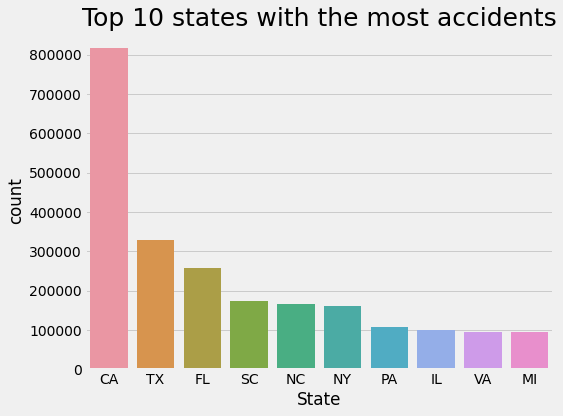

In [ ]:
sns.countplot(data['State'], order=data['State'].value_counts().iloc[:10].index)
plt.xticks(rotation=0)
plt.title("Top 10 states with the most accidents", fontsize=25)
plt.tight_layout()

**Total accidents by hour**

/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



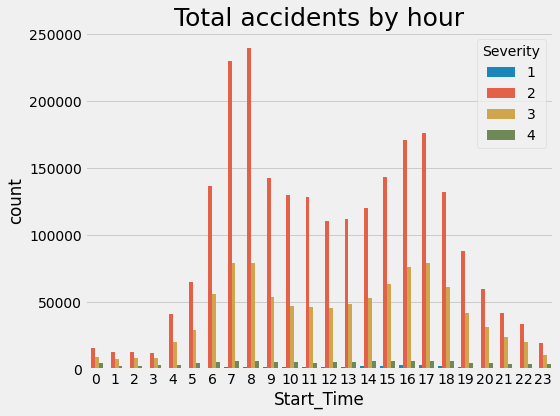

In [ ]:
data.Start_Time=pd.to_datetime(data.Start_Time)
data.End_Time=pd.to_datetime(data.End_Time)

sns.countplot(data['Start_Time'].dt.hour, hue=data['Severity'])
plt.xticks(rotation=0)
plt.title("Total accidents by hour", fontsize=25)
plt.tight_layout()

**Total accidents by different month**

/usr/local/lib/python3.6/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



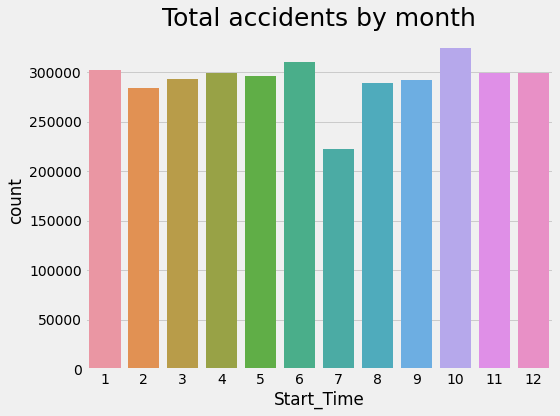

In [ ]:
sns.countplot(data['Start_Time'].dt.month)
plt.xticks(rotation=0)
plt.title("Total accidents by month", fontsize=25)
plt.tight_layout()

Average severity at different hours

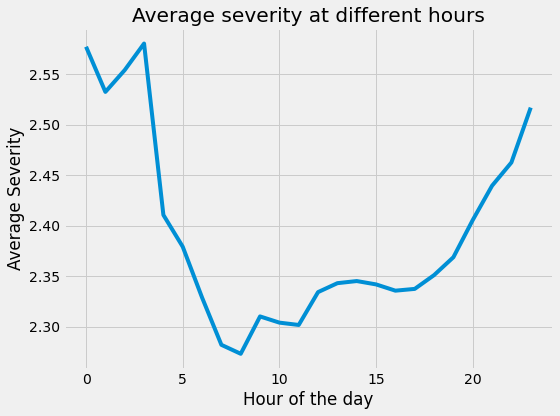

In [ ]:
df = data.copy()

df['Accident_hour']=df['Start_Time'].dt.hour

df.groupby('Accident_hour')['Severity'].mean().plot(kind='line')
plt.xlabel('Hour of the day')
plt.ylabel('Average Severity')
plt.title('Average severity at different hours')
plt.tight_layout()

**Average Severity by Month**

Text(0.5, 1.0, 'Average Severity by Month')

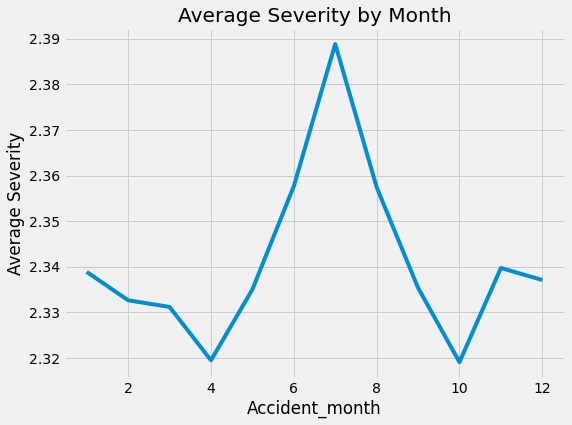

In [ ]:
df['Accident_month']=df['Start_Time'].dt.month
df.groupby('Accident_month')['Severity'].mean().plot(kind='line')
plt.ylabel('Average Severity')
plt.title('Average Severity by Month')

***Plotting the Maps***

**Accidents count (group by States)**

In [ ]:
state_count_acc = pd.value_counts(data['State'])

fig = go.Figure(data=go.Choropleth(locations=state_count_acc.index, z = state_count_acc.values.astype(float), locationmode = 'USA-states', colorscale = 'Reds', colorbar_title = "Count Accidents"))

fig.update_layout(title_text = '2016 - 2019 US Traffic Accident Dataset by State',geo_scope='usa',)

fig.show()

**Severity of accidents**

In [ ]:
data_sever = data.sample(n=10000)

fig = go.Figure(data=go.Scattergeo(locationmode = 'USA-states',lon = data_sever['Start_Lng'],lat = data_sever['Start_Lat'],text = data_sever['City'],mode = 'markers',
                                   marker = dict(size = 8,opacity = 0.8,reversescale = True,autocolorscale = False,symbol = 'circle', line = dict( width=1, color='rgba(102, 102, 102)'), colorscale = 'Reds', cmin = data_sever['Severity'].max(), color = data_sever['Severity'], cmax = 1,
            colorbar_title="Severity"
        )))

fig.update_layout(
        title = 'Severity of accidents',
        geo = dict(
            scope='usa',
            projection_type='albers usa',
            showland = True,
            landcolor = "rgb(250, 250, 250)",
            subunitcolor = "rgb(217, 217, 217)",
            countrycolor = "rgb(217, 217, 217)",
            countrywidth = 0.7,
            subunitwidth = 0.7
        ),
    )
fig.show()

# **Data Preprocessing**

**Data Cleaning**

Handling Missing Values

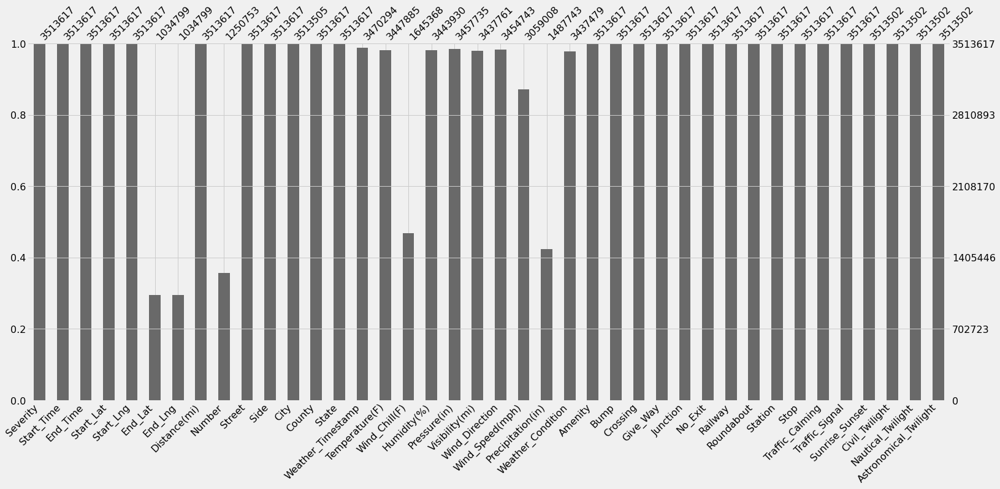

In [ ]:
# Visualizing missing values
msno.bar(data)

In [ ]:
# Getting number of null values in each column
data.isna().sum()

Severity                       0
Start_Time                     0
End_Time                       0
Start_Lat                      0
Start_Lng                      0
End_Lat                  2478818
End_Lng                  2478818
Distance(mi)                   0
Number                   2262864
Street                         0
Side                           0
City                         112
County                         0
State                          0
Weather_Timestamp          43323
Temperature(F)             65732
Wind_Chill(F)            1868249
Humidity(%)                69687
Pressure(in)               55882
Visibility(mi)             75856
Wind_Direction             58874
Wind_Speed(mph)           454609
Precipitation(in)        2025874
Weather_Condition          76138
Amenity                        0
Bump                           0
Crossing                       0
Give_Way                       0
Junction                       0
No_Exit                        0
Railway   

In [ ]:
# Getting value counts

for column in data.columns:
  print(data[column].value_counts())
  print("*" * 40)

2    2373210
3     998913
4     112320
1      29174
Name: Severity, dtype: int64
****************************************
2017-05-15 09:22:55    74
2018-11-25 01:22:49    53
2019-10-26 08:45:17    49
2018-11-12 00:37:27    40
2018-12-18 07:11:45    37
                       ..
2019-05-20 13:19:16     1
2019-08-08 17:19:04     1
2017-08-22 11:03:41     1
2018-09-26 17:07:20     1
2018-03-19 11:36:23     1
Name: Start_Time, Length: 3200042, dtype: int64
****************************************
2017-05-15 15:22:55    73
2019-10-26 09:14:51    49
2020-02-14 00:00:00    46
2018-11-25 02:51:02    46
2020-02-12 00:00:00    42
                       ..
2016-07-08 11:24:44     1
2018-10-14 11:05:36     1
2019-12-09 11:44:23     1
2018-12-17 12:05:44     1
2019-11-07 18:14:17     1
Name: End_Time, Length: 3246120, dtype: int64
****************************************
37.808498    570
33.941364    566
42.476501    534
33.744976    533
34.858925    494
            ... 
39.703094      1
44.294941  

In [ ]:
# Getting number of unique values

for column in data.columns:
  print(column, ":", len(data[column].unique()))
  print("Data : ", data[column].unique())
  print("*" * 40)

Severity : 4
Data :  [3 2 1 4]
****************************************
Start_Time : 3200042
Data :  ['2016-02-08T05:46:00.000000000' '2016-02-08T06:07:59.000000000'
 '2016-02-08T06:49:27.000000000' ... '2019-08-23T19:11:30.000000000'
 '2019-08-23T19:00:21.000000000' '2019-08-23T18:52:06.000000000']
****************************************
End_Time : 3246120
Data :  ['2016-02-08T11:00:00.000000000' '2016-02-08T06:37:59.000000000'
 '2016-02-08T07:19:27.000000000' ... '2019-08-23T19:28:49.000000000'
 '2019-08-23T19:29:42.000000000' '2019-08-23T19:21:31.000000000']
****************************************
Start_Lat : 1124695
Data :  [39.865147 39.928059 39.063148 ... 34.120911 33.943599 34.239104]
****************************************
Start_Lng : 1113407
Data :  [ -84.058723  -82.831184  -84.032608 ... -118.416176 -117.14806
 -117.84779 ]
****************************************
End_Lat : 375075
Data :  [      nan 40.11206  39.86501  ... 34.239104 33.98311  34.13736 ]
*****************

In [ ]:
# Copying the original data
preprocessed_data = data.copy()

In [ ]:
cols = ['End_Lat', 'End_Lng', 'Number', 'Temperature(F)', 'Wind_Chill(F)', 'Humidity(%)', 'Pressure(in)', 'Visibility(mi)', 'Wind_Speed(mph)', 'Precipitation(in)']
imp_mean = IterativeImputer(max_iter=1000)
preprocessed_data[cols] = imp_mean.fit_transform(preprocessed_data[cols])             

In [ ]:
preprocessed_data.City.fillna(preprocessed_data.City.value_counts().index[0], inplace=True)

preprocessed_data.Side.replace(' ', preprocessed_data.Side.value_counts().index[0], inplace=True)

preprocessed_data.Wind_Direction.fillna(preprocessed_data.Wind_Direction.value_counts().index[0], inplace=True)

preprocessed_data.Weather_Condition.fillna(preprocessed_data.Weather_Condition.value_counts().index[0], inplace=True)

preprocessed_data.Sunrise_Sunset.fillna(preprocessed_data.Sunrise_Sunset.value_counts().index[0], inplace=True)

preprocessed_data.Civil_Twilight.fillna(preprocessed_data.Civil_Twilight.value_counts().index[0], inplace=True)

preprocessed_data.Nautical_Twilight.fillna(preprocessed_data.Nautical_Twilight.value_counts().index[0], inplace=True)

preprocessed_data.Astronomical_Twilight.fillna(preprocessed_data.Astronomical_Twilight.value_counts().index[0], inplace=True)

preprocessed_data.Weather_Timestamp.fillna(method='ffill', inplace=True)

In [ ]:
preprocessed_data.isna().sum()

Severity                 0
Start_Time               0
End_Time                 0
Start_Lat                0
Start_Lng                0
End_Lat                  0
End_Lng                  0
Distance(mi)             0
Number                   0
Street                   0
Side                     0
City                     0
County                   0
State                    0
Weather_Timestamp        0
Temperature(F)           0
Wind_Chill(F)            0
Humidity(%)              0
Pressure(in)             0
Visibility(mi)           0
Wind_Direction           0
Wind_Speed(mph)          0
Precipitation(in)        0
Weather_Condition        0
Amenity                  0
Bump                     0
Crossing                 0
Give_Way                 0
Junction                 0
No_Exit                  0
Railway                  0
Roundabout               0
Station                  0
Stop                     0
Traffic_Calming          0
Traffic_Signal           0
Sunrise_Sunset           0
C

**Data Transformation**

Label Encoding

In [ ]:
encoder = LabelEncoder()

for col in preprocessed_data.columns:
    preprocessed_data[col] = encoder.fit_transform(preprocessed_data[col])

In [ ]:
preprocessed_data.head()

,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Number,Street,Side,City,County,State,Weather_Timestamp,Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Direction,Wind_Speed(mph),Precipitation(in),Weather_Condition,Amenity,Bump,Crossing,Give_Way,Junction,No_Exit,Railway,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
0,2,1,22,770170,678272,1961513,1530629,11,1306341,91534,1,2543,1051,33,3,362,47671,29145,7755,31311,1,114831,1172410,55,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,1
1,1,3,1,776102,713475,1877904,1812466,11,249761,49614,0,8879,553,33,1,368,51892,29531,7077,31311,1,63479,482936,55,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0
2,1,5,2,707003,678727,1883392,734590,11,1334117,153523,1,11609,322,33,5,357,50992,29531,7462,31311,16,4422,902584,78,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0,0
3,2,7,3,755433,672642,1977339,1161038,11,1279260,91551,1,2543,1051,33,6,352,44096,29421,6901,11528,16,15488,962128,75,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
4,1,8,4,743260,673752,1890000,430397,11,1366256,107160,1,2543,1051,33,9,357,50992,28911,7077,319,16,4422,1344796,75,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0


Handling Outliers

In [ ]:
envelope = EllipticEnvelope()

predicted = envelope.fit_predict(preprocessed_data)

/usr/local/lib/python3.6/dist-packages/sklearn/covariance/_robust_covariance.py:170: RuntimeWarning:

Determinant has increased; this should not happen: log(det) > log(previous_det) (312.483933101326500 > 310.591794760857397). You may want to try with a higher value of support_fraction (current value: 0.500).



In [ ]:
outlier_info = np.unique(predicted, return_counts = True)
print(outlier_info)

print("Number of outliers : {} ; Number of inliers : {}".format(outlier_info[1][0], outlier_info[1][1]))

(array([-1,  1]), array([ 351362, 3162255]))
Number of outliers : 351362 ; Number of inliers : 3162255


In [ ]:
preprocessed_data = preprocessed_data[predicted == 1]

preprocessed_data.shape

(3162255, 40)

**Data Integrity**

Correlation Analysis 

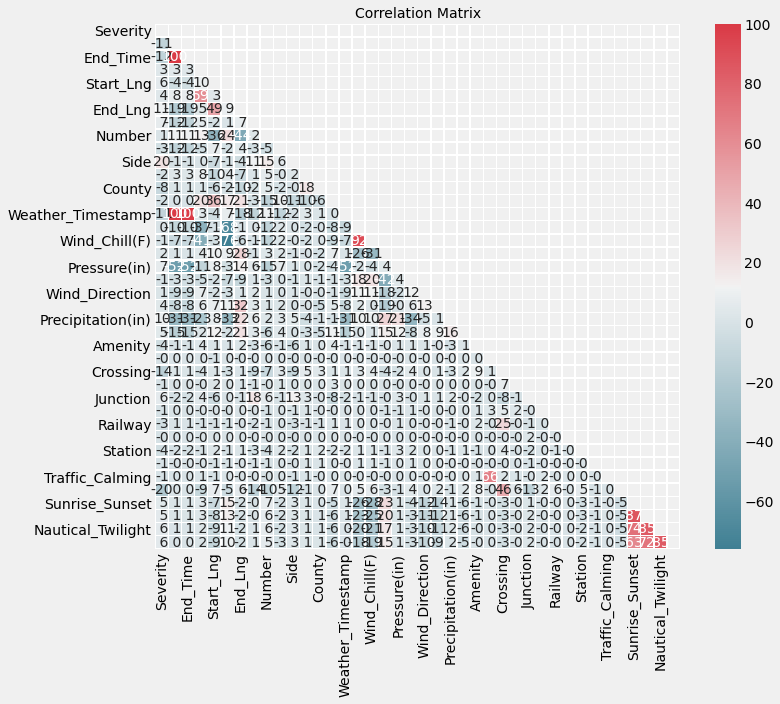

In [ ]:
corrmat(preprocessed_data.corr(), inflate=True)
plt.show()

In [ ]:
cor_matrix = preprocessed_data.corr().abs()
cor_matrix

,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Number,Street,Side,City,County,State,Weather_Timestamp,Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Direction,Wind_Speed(mph),Precipitation(in),Weather_Condition,Amenity,Bump,Crossing,Give_Way,Junction,No_Exit,Railway,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
Severity,1.000000,0.114709,0.115358,0.034054,0.061893,0.037541,0.111501,0.065419,0.007915,0.030088,0.201854,0.020539,0.078109,0.022519,0.113570,0.000143,0.014566,0.020672,0.070132,0.013934,0.011368,0.040960,0.097602,0.045256,0.041251,0.003911,0.143822,0.008388,0.060504,0.005776,0.034912,0.004063,0.035596,0.009663,0.005265,0.202264,0.047792,0.052461,0.057910,0.058017
Start_Time,0.114709,1.000000,0.999934,0.031763,0.043784,0.075344,0.186155,0.121222,0.111174,0.117164,0.014499,0.027933,0.011894,0.001160,0.999621,0.095680,0.074525,0.009120,0.521910,0.029337,0.089461,0.084165,0.313099,0.153211,0.007583,0.003520,0.014075,0.000407,0.023992,0.001507,0.005342,0.000027,0.017109,0.002298,0.000790,0.003485,0.012685,0.010390,0.005341,0.001124
End_Time,0.115358,0.999934,1.000000,0.031785,0.044343,0.075029,0.186575,0.121611,0.111397,0.118148,0.014239,0.028126,0.012037,0.000249,0.999448,0.095645,0.074459,0.008658,0.522825,0.029168,0.089190,0.083810,0.313155,0.153775,0.007600,0.003525,0.014079,0.000392,0.023652,0.001482,0.005311,0.000012,0.017375,0.002396,0.000787,0.003644,0.012703,0.010472,0.005495,0.001315
Start_Lat,0.034054,0.031763,0.031785,1.000000,0.096679,0.587733,0.048361,0.052747,0.127841,0.048740,0.001796,0.084664,0.014388,0.204129,0.031624,0.367431,0.411810,0.042486,0.113436,0.054715,0.069769,0.059353,0.225419,0.022592,0.037455,0.002919,0.035632,0.003954,0.037104,0.002989,0.009744,0.000290,0.011787,0.004853,0.008908,0.088375,0.031357,0.025678,0.018234,0.016350
Start_Lng,0.061893,0.043784,0.044343,0.096679,1.000000,0.034788,0.486825,0.017256,0.361024,0.066321,0.069112,0.100064,0.062216,0.358935,0.041190,0.005200,0.029483,0.100875,0.076859,0.016080,0.015543,0.074900,0.079236,0.121610,0.007936,0.008355,0.014113,0.016793,0.062168,0.000746,0.012634,0.001069,0.018173,0.008920,0.005049,0.072988,0.068834,0.080793,0.087585,0.094910
End_Lat,0.037541,0.075344,0.075029,0.587733,0.034788,1.000000,0.091231,0.006356,0.238238,0.020047,0.005187,0.035367,0.022186,0.167607,0.074102,0.684726,0.759764,0.090954,0.032207,0.072234,0.027239,0.105839,0.327286,0.021023,0.006383,0.002026,0.028100,0.000253,0.001480,0.003868,0.007871,0.000621,0.013920,0.006637,0.003261,0.049507,0.154622,0.133020,0.110716,0.095488
End_Lng,0.111501,0.186155,0.186575,0.048361,0.486825,0.091231,1.000000,0.074079,0.440200,0.040264,0.040850,0.073089,0.098819,0.208962,0.183558,0.007346,0.057261,0.276065,0.135956,0.087964,0.008615,0.321946,0.218679,0.206920,0.016760,0.004508,0.009568,0.008019,0.010273,0.002682,0.002772,0.000873,0.011954,0.001084,0.000706,0.056640,0.015705,0.023125,0.023092,0.023646
Distance(mi),0.065419,0.121222,0.121611,0.052747,0.017256,0.006356,0.074079,1.000000,0.020948,0.031848,0.108604,0.006011,0.023821,0.025875,0.121164,0.000512,0.005951,0.006330,0.057424,0.007952,0.021188,0.031961,0.064630,0.031721,0.025169,0.002279,0.086103,0.011012,0.175271,0.000868,0.018841,0.002168,0.026462,0.006103,0.003171,0.141051,0.004547,0.001979,0.007730,0.009328
Number,0.007915,0.111174,0.111397,0.127841,0.361024,0.238238,0.440200,0.020948,1.000000,0.045826,0.148300,0.051956,0.045500,0.147775,0.109362,0.119790,0.124262,0.027510,0.152301,0.033277,0.009863,0.011724,0.017439,0.059262,0.062133,0.000215,0.073925,0.003596,0.058333,0.009834,0.014490,0.002255,0.038599,0.007085,0.004228,0.097773,0.067057,0.064767,0.058592,0.054427
Street,0.030088,0.117164,0.118148,0.048740,0.066321,0.020047,0.040264,0.031848,0.045826,1.000000,0.055293,0.000877,0.018379,0.104098,0.115570,0.021324,0.019121,0.019085,0.070548,0.000487,0.000063,0.015442,0.031509,0.035253,0

In [ ]:
upper_tri = cor_matrix.where(np.triu(np.ones(cor_matrix.shape),k=1).astype(np.bool))

to_drop = [column for column in upper_tri.columns if any(upper_tri[column] > 0.95)]
print(); 
print("Highly Correlated columns to remove :{}".format(to_drop))


Highly Correlated columns to remove :['End_Time', 'Weather_Timestamp']


In [ ]:
preprocessed_data = preprocessed_data.drop(to_drop, axis=1)
print(); 
preprocessed_data.shape

(3162255, 38)

**Data Reduction**

Principal Component Analysis (Performance Decreased)

Sampling Without Replacement

In [ ]:
sampled_data = preprocessed_data.sample(100000, random_state = 40)

In [ ]:
sampled_data.head()

,Severity,Start_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),Number,Street,Side,City,County,State,Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Direction,Wind_Speed(mph),Precipitation(in),Weather_Condition,Amenity,Bump,Crossing,Give_Way,Junction,No_Exit,Railway,Roundabout,Station,Stop,Traffic_Calming,Traffic_Signal,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight
223874,2,255885,776536,711251,1488539,1867123,11,825338,91534,1,2128,553,33,2549,377816,28176,18755,319,22,336466,1172410,55,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0
1219815,1,2104856,767695,1015396,511052,1034407,0,176018,37673,1,4022,229,29,26582,1179535,557,8910,31311,21,308540,482936,6,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
516357,1,3105133,664456,129291,247001,1627999,0,317999,78054,1,8731,1339,3,26710,1519491,335,7077,31311,12,308540,467928,13,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0
2270289,2,959861,660158,940753,1713659,967324,0,1055516,91644,1,2855,1261,43,570,219351,5712,17940,26617,17,198718,795894,5,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
252776,2,130170,727594,954247,116324,1054865,0,436486,89925,1,11739,729,18,26658,1480933,1338,19198,31311,23,278430,1117841,75,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


# **Splitting Data Into Training And Testing**

In [ ]:
X = sampled_data.drop(['Severity'], axis = 1)
y = sampled_data['Severity']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size = 0.7, test_size=0.3, random_state=42)

# **Classification**

Defining Performance Function

In [ ]:
def print_performance (clf, X_train, X_test, y_train, y_test, train=True):  # clf = classifier
    lb = preprocessing.LabelBinarizer()
    lb.fit(y_train)

    if train:
        # Training Performance
        res = clf.predict(X_train)

        print("Train Result:\n")

        print("Accuracy score: {0:.4f}\n"
              .format(accuracy_score(y_train, res)))
        
        print("Error rate: {0:.4f}\n"
              .format(1-accuracy_score(y_train, res)))

        print("recall of the positive class is also known as sensitivity ; recall of the negative class is specificity")
        print("Classification Report: \n {}"
              .format(classification_report(y_train, res)))
        print("")
        
        cm = confusion_matrix(y_train, res)
        print("Confusion Matrix: \n {}\n".format(cm))

        if type(clf).__name__ is not 'StackingClassifier':
          disp = plot_confusion_matrix(clf, X_train, y_train,cmap=plt.cm.GnBu, values_format = 'd')
          plt.grid(False)
          plt.show()
          print()

        print("ROC AUC: {0:.4f}\n"
              .format(roc_auc_score(lb.transform(y_train), lb.transform(res))))

        res = cross_val_score(clf, X_train, y_train, cv=10, scoring='accuracy', n_jobs=-1)

        print("Average Accuracy: \t {0:.4f}".format(np.mean(res)))
        print("Accuracy SD: \t\t {0:.4f}".format(np.std(res)))

    else:
        # Testing Performance
        res_test = clf.predict(X_test)

        print("Test Result:\n")

        print("Accuracy score: {0:.4f}\n"
              .format(accuracy_score(y_test, res_test)))
        
        print("Error rate: {0:.4f}\n"
              .format(1-accuracy_score(y_test, res_test)))
        
        print("recall of the positive class is also known as sensitivity ; recall of the negative class is specificity")
        print("Classification Report: \n {}\n"
              .format(classification_report(y_test, res_test)))

        cm = confusion_matrix(y_test, res_test)
        print("Confusion Matrix: \n {}\n".format(cm))
          
        if type(clf).__name__ is not 'StackingClassifier':
          disp = plot_confusion_matrix(clf, X_test, y_test,cmap=plt.cm.Oranges, values_format = 'd')
          plt.grid(False)
          plt.show()
          print()

        print("ROC AUC: {0:.4f}\n"
              .format(roc_auc_score(lb.transform(y_test), lb.transform(res_test))))
        
        res = cross_val_score(clf, X_test, y_test, cv=10, scoring='accuracy', n_jobs=-1)

        print("Average Accuracy: \t {0:.4f}".format(np.mean(res)))
        print("Accuracy SD: \t\t {0:.4f}".format(np.std(res)))



*Defining Classification Function*

In [ ]:
def classify(clf):

  sig = inspect.signature(clf.__init__)

  try:
    sig.parameters['n_jobs']
    classifier = clf(n_jobs = -1)
  except Exception as e:
    classifier = clf()
  
  classifier.fit(X_train, y_train)


  print_performance(classifier, X_train, X_test, y_train, y_test, train=False)
  print("=" * 80)
  print_performance(classifier, X_train, X_test, y_train, y_test, train=True)
  
  return classifier

**Decision Tree**

Test Result:

Accuracy score: 0.7729

Error rate: 0.2271

recall of the positive class is also known as sensitivity ; recall of the negative class is specificity
Classification Report: 
               precision    recall  f1-score   support

           0       0.43      0.44      0.44       248
           1       0.84      0.84      0.84     20637
           2       0.65      0.66      0.65      8633
           3       0.23      0.24      0.24       482

    accuracy                           0.77     30000
   macro avg       0.54      0.55      0.54     30000
weighted avg       0.77      0.77      0.77     30000


Confusion Matrix: 
 [[  110   111    23     4]
 [  117 17266  2968   286]
 [   23  2821  5696    93]
 [    6   257   103   116]]



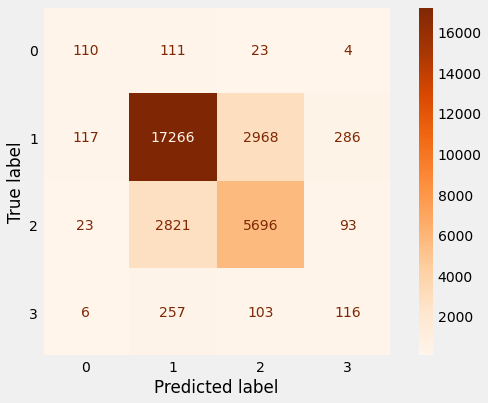


ROC AUC: 0.7097

Average Accuracy: 	 0.7547
Accuracy SD: 		 0.0069
Train Result:

Accuracy score: 1.0000

Error rate: 0.0000

recall of the positive class is also known as sensitivity ; recall of the negative class is specificity
Classification Report: 
               precision    recall  f1-score   support

           0       1.00      1.00      1.00       544
           1       1.00      1.00      1.00     48496
           2       1.00      1.00      1.00     19800
           3       1.00      1.00      1.00      1160

    accuracy                           1.00     70000
   macro avg       1.00      1.00      1.00     70000
weighted avg       1.00      1.00      1.00     70000


Confusion Matrix: 
 [[  544     0     0     0]
 [    0 48496     0     0]
 [    0     0 19800     0]
 [    0     0     0  1160]]



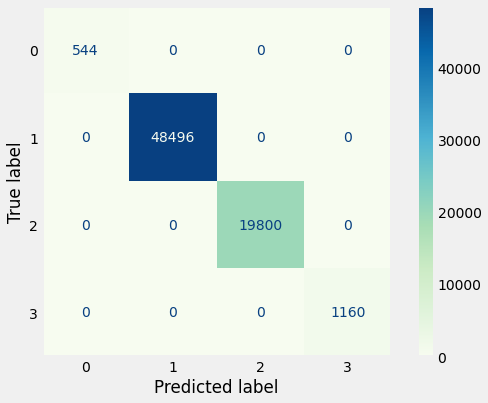


ROC AUC: 1.0000

Average Accuracy: 	 0.7737
Accuracy SD: 		 0.0059


In [ ]:
desicion_tree_classifier = classify(DecisionTreeClassifier)

In [ ]:
dot_data = tree.export_graphviz(desicion_tree_classifier, out_file=None, 
                                feature_names=X.columns,  
                                class_names=y.name,
                                filled=True)

# Draw graph
graph = graphviz.Source(dot_data, format="png") 
graph

**Naive Bayes**

Test Result:

Accuracy score: 0.6669

Error rate: 0.3331

recall of the positive class is also known as sensitivity ; recall of the negative class is specificity
Classification Report: 
               precision    recall  f1-score   support

           0       0.08      0.53      0.14       248
           1       0.74      0.84      0.79     20637
           2       0.62      0.29      0.40      8633
           3       0.10      0.22      0.13       482

    accuracy                           0.67     30000
   macro avg       0.39      0.47      0.37     30000
weighted avg       0.69      0.67      0.66     30000


Confusion Matrix: 
 [[  132   112     2     2]
 [ 1228 17239  1512   658]
 [  220  5573  2531   309]
 [   22   346    10   104]]



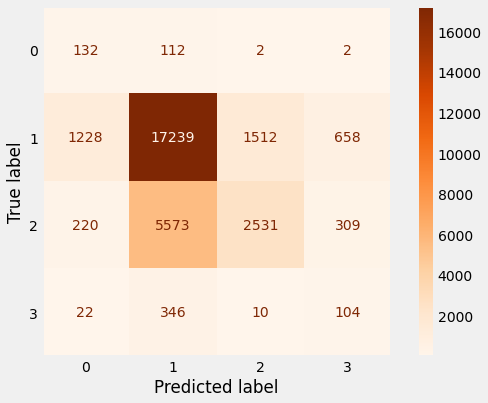


ROC AUC: 0.6349

Average Accuracy: 	 0.6709
Accuracy SD: 		 0.0079
Train Result:

Accuracy score: 0.6677

Error rate: 0.3323

recall of the positive class is also known as sensitivity ; recall of the negative class is specificity
Classification Report: 
               precision    recall  f1-score   support

           0       0.08      0.52      0.14       544
           1       0.74      0.84      0.79     48496
           2       0.62      0.28      0.39     19800
           3       0.09      0.21      0.13      1160

    accuracy                           0.67     70000
   macro avg       0.38      0.46      0.36     70000
weighted avg       0.69      0.67      0.66     70000


Confusion Matrix: 
 [[  282   254     7     1]
 [ 2799 40673  3376  1648]
 [  473 13027  5544   756]
 [   40   855    25   240]]



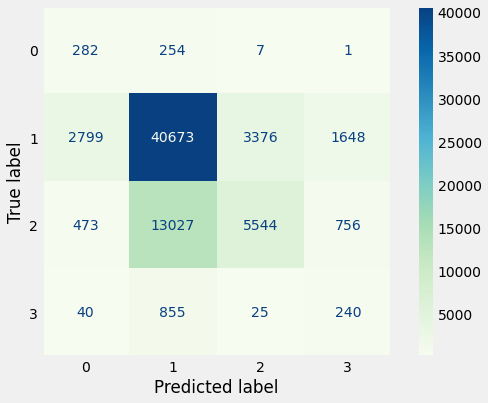


ROC AUC: 0.6295

Average Accuracy: 	 0.6665
Accuracy SD: 		 0.0062


In [ ]:
gaussian_naive_bayes_classifier = classify(GaussianNB)

**K Nearest Neighbors**

Test Result:

Accuracy score: 0.7070

Error rate: 0.2930

recall of the positive class is also known as sensitivity ; recall of the negative class is specificity
Classification Report: 
               precision    recall  f1-score   support

           0       0.42      0.34      0.37       248
           1       0.77      0.83      0.80     20637
           2       0.53      0.47      0.50      8633
           3       0.25      0.03      0.05       482

    accuracy                           0.71     30000
   macro avg       0.49      0.42      0.43     30000
weighted avg       0.69      0.71      0.70     30000


Confusion Matrix: 
 [[   84   150    13     1]
 [   94 17037  3476    30]
 [   18  4529  4075    11]
 [    6   387    75    14]]



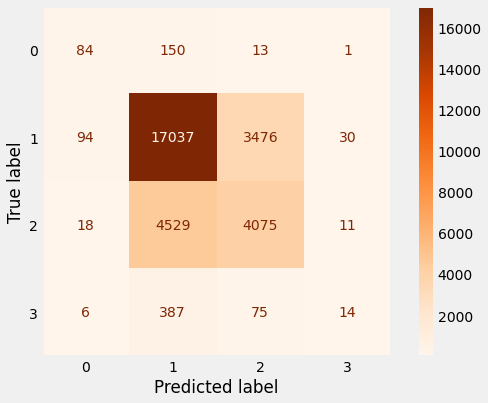


ROC AUC: 0.6190

Average Accuracy: 	 0.7010
Accuracy SD: 		 0.0054
Train Result:

Accuracy score: 0.8008

Error rate: 0.1992

recall of the positive class is also known as sensitivity ; recall of the negative class is specificity
Classification Report: 
               precision    recall  f1-score   support

           0       0.65      0.50      0.57       544
           1       0.84      0.89      0.86     48496
           2       0.70      0.63      0.66     19800
           3       0.69      0.08      0.15      1160

    accuracy                           0.80     70000
   macro avg       0.72      0.53      0.56     70000
weighted avg       0.79      0.80      0.79     70000


Confusion Matrix: 
 [[  274   251    16     3]
 [  103 43205  5159    29]
 [   34  7273 12483    10]
 [    8   910   148    94]]



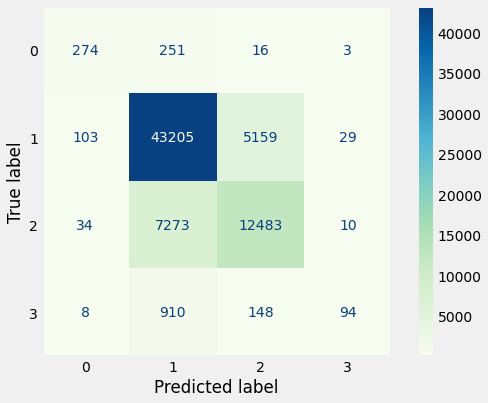


ROC AUC: 0.7006

Average Accuracy: 	 0.7076
Accuracy SD: 		 0.0043


In [ ]:
knn_classifier = classify(KNeighborsClassifier)

*Classification By Ensemble Methods*

In [ ]:
def ensemble_classify(clf, base = None):

  sig = inspect.signature(clf.__init__)

  try:
    sig.parameters['n_jobs']
    classifier = clf(base_estimator = base, n_jobs = -1)
  except Exception as e:
    classifier = clf(base_estimator = base)
  
  classifier.fit(X_train, y_train)

  print_performance(classifier, X_train, X_test, y_train, y_test, train=False)
  print("=" * 40)
  print_performance(classifier, X_train, X_test, y_train, y_test, train=True)
  
  return classifier

**Random Forest**

Test Result:

Accuracy score: 0.8360

Error rate: 0.1640

recall of the positive class is also known as sensitivity ; recall of the negative class is specificity
Classification Report: 
               precision    recall  f1-score   support

           0       0.89      0.29      0.44       248
           1       0.85      0.93      0.89     20637
           2       0.80      0.66      0.72      8633
           3       0.70      0.11      0.20       482

    accuracy                           0.84     30000
   macro avg       0.81      0.50      0.56     30000
weighted avg       0.83      0.84      0.83     30000


Confusion Matrix: 
 [[   72   166    10     0]
 [    6 19257  1357    17]
 [    3  2927  5696     7]
 [    0   382    45    55]]



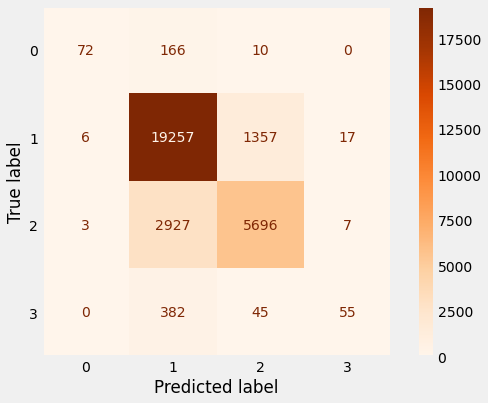


ROC AUC: 0.6949

Average Accuracy: 	 0.8252
Accuracy SD: 		 0.0068
Train Result:

Accuracy score: 1.0000

Error rate: 0.0000

recall of the positive class is also known as sensitivity ; recall of the negative class is specificity
Classification Report: 
               precision    recall  f1-score   support

           0       1.00      1.00      1.00       544
           1       1.00      1.00      1.00     48496
           2       1.00      1.00      1.00     19800
           3       1.00      1.00      1.00      1160

    accuracy                           1.00     70000
   macro avg       1.00      1.00      1.00     70000
weighted avg       1.00      1.00      1.00     70000


Confusion Matrix: 
 [[  544     0     0     0]
 [    1 48495     0     0]
 [    0     2 19798     0]
 [    0     0     0  1160]]



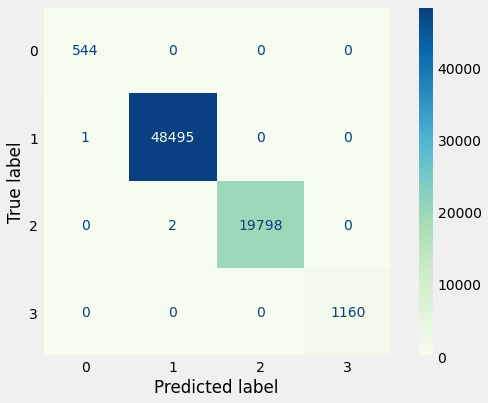


ROC AUC: 1.0000

Average Accuracy: 	 0.8375
Accuracy SD: 		 0.0035


In [ ]:
forest_classifier = classify(RandomForestClassifier)

**Bagging + Random Forest**

Test Result:

Accuracy score: 0.8329

Error rate: 0.1671

recall of the positive class is also known as sensitivity ; recall of the negative class is specificity
Classification Report: 
               precision    recall  f1-score   support

           0       0.97      0.27      0.43       248
           1       0.84      0.94      0.89     20637
           2       0.81      0.64      0.71      8633
           3       0.80      0.07      0.12       482

    accuracy                           0.83     30000
   macro avg       0.85      0.48      0.54     30000
weighted avg       0.83      0.83      0.82     30000


Confusion Matrix: 
 [[   68   172     8     0]
 [    2 19343  1286     6]
 [    0  3087  5544     2]
 [    0   410    40    32]]



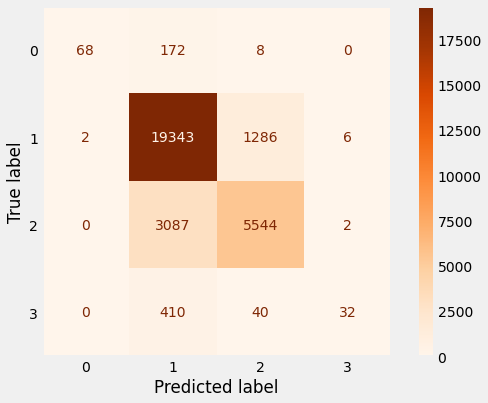


ROC AUC: 0.6832

Average Accuracy: 	 0.8225
Accuracy SD: 		 0.0074
Train Result:

Accuracy score: 0.9720

Error rate: 0.0280

recall of the positive class is also known as sensitivity ; recall of the negative class is specificity
Classification Report: 
               precision    recall  f1-score   support

           0       1.00      0.80      0.88       544
           1       0.97      0.99      0.98     48496
           2       0.98      0.94      0.96     19800
           3       1.00      0.76      0.86      1160

    accuracy                           0.97     70000
   macro avg       0.99      0.87      0.92     70000
weighted avg       0.97      0.97      0.97     70000


Confusion Matrix: 
 [[  433   108     3     0]
 [    1 48197   298     0]
 [    0  1270 18530     0]
 [    1   259    20   880]]



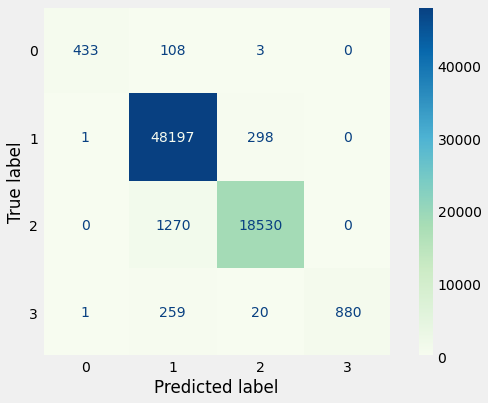


ROC AUC: 0.9252

Average Accuracy: 	 0.8348
Accuracy SD: 		 0.0040


In [ ]:
bag_classifier = ensemble_classify(BaggingClassifier, base = forest_classifier)

**Ada Boost + Decision Tree**

Test Result:

Accuracy score: 0.7755

Error rate: 0.2245

recall of the positive class is also known as sensitivity ; recall of the negative class is specificity
Classification Report: 
               precision    recall  f1-score   support

           0       0.43      0.44      0.44       248
           1       0.85      0.84      0.84     20637
           2       0.65      0.67      0.66      8633
           3       0.23      0.23      0.23       482

    accuracy                           0.78     30000
   macro avg       0.54      0.54      0.54     30000
weighted avg       0.78      0.78      0.78     30000


Confusion Matrix: 
 [[  109   108    24     7]
 [  111 17297  2931   298]
 [   25  2779  5745    84]
 [    7   249   113   113]]



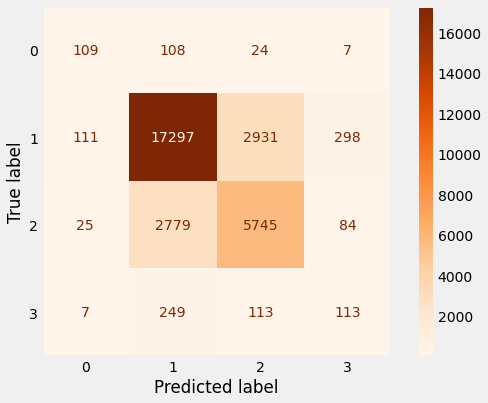


ROC AUC: 0.7101

Average Accuracy: 	 0.7557
Accuracy SD: 		 0.0075
Train Result:

Accuracy score: 1.0000

Error rate: 0.0000

recall of the positive class is also known as sensitivity ; recall of the negative class is specificity
Classification Report: 
               precision    recall  f1-score   support

           0       1.00      1.00      1.00       544
           1       1.00      1.00      1.00     48496
           2       1.00      1.00      1.00     19800
           3       1.00      1.00      1.00      1160

    accuracy                           1.00     70000
   macro avg       1.00      1.00      1.00     70000
weighted avg       1.00      1.00      1.00     70000


Confusion Matrix: 
 [[  544     0     0     0]
 [    0 48496     0     0]
 [    0     0 19800     0]
 [    0     0     0  1160]]



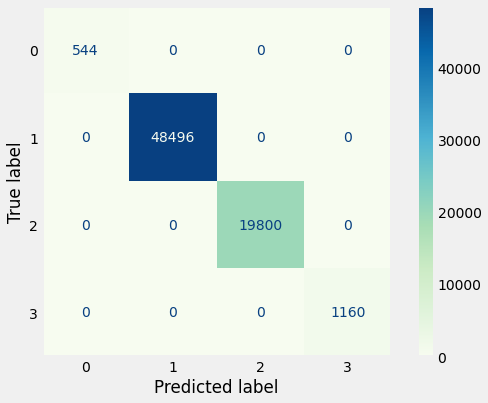


ROC AUC: 1.0000

Average Accuracy: 	 0.7716
Accuracy SD: 		 0.0059


In [ ]:
ada_classifier = ensemble_classify(AdaBoostClassifier, base = desicion_tree_classifier)

**Gradient Boosting**

Test Result:

Accuracy score: 0.8176

Error rate: 0.1824

recall of the positive class is also known as sensitivity ; recall of the negative class is specificity
Classification Report: 
               precision    recall  f1-score   support

           0       0.66      0.26      0.37       248
           1       0.83      0.93      0.88     20637
           2       0.78      0.61      0.68      8633
           3       0.60      0.21      0.31       482

    accuracy                           0.82     30000
   macro avg       0.72      0.50      0.56     30000
weighted avg       0.81      0.82      0.81     30000


Confusion Matrix: 
 [[   64   175     9     0]
 [   26 19122  1446    43]
 [    5  3362  5244    22]
 [    2   327    54    99]]



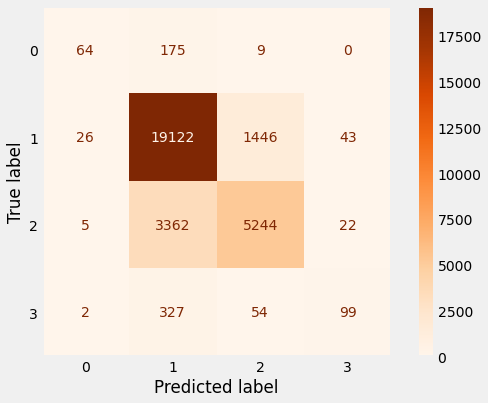


ROC AUC: 0.6889

Average Accuracy: 	 0.8163
Accuracy SD: 		 0.0069
Train Result:

Accuracy score: 0.8251

Error rate: 0.1749

recall of the positive class is also known as sensitivity ; recall of the negative class is specificity
Classification Report: 
               precision    recall  f1-score   support

           0       0.81      0.36      0.50       544
           1       0.84      0.93      0.88     48496
           2       0.78      0.61      0.69     19800
           3       0.70      0.25      0.37      1160

    accuracy                           0.83     70000
   macro avg       0.78      0.54      0.61     70000
weighted avg       0.82      0.83      0.82     70000


Confusion Matrix: 
 [[  195   325    22     2]
 [   36 45171  3207    82]
 [    9  7652 12094    45]
 [    2   737   127   294]]



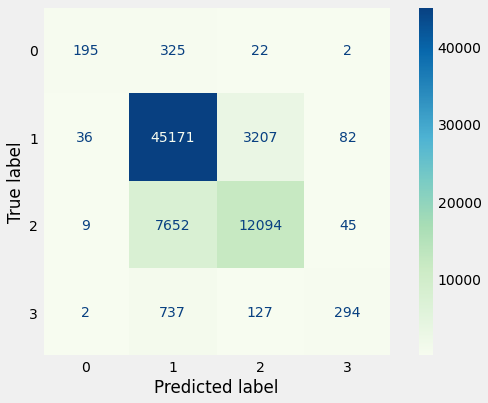


ROC AUC: 0.7099

Average Accuracy: 	 0.8198
Accuracy SD: 		 0.0024


In [ ]:
gradient_classifier = classify(GradientBoostingClassifier)

**XG Boosting**

Test Result:

Accuracy score: 0.8137

Error rate: 0.1863

recall of the positive class is also known as sensitivity ; recall of the negative class is specificity
Classification Report: 
               precision    recall  f1-score   support

           0       0.94      0.24      0.38       248
           1       0.82      0.93      0.87     20637
           2       0.78      0.59      0.67      8633
           3       0.59      0.14      0.23       482

    accuracy                           0.81     30000
   macro avg       0.78      0.48      0.54     30000
weighted avg       0.81      0.81      0.80     30000


Confusion Matrix: 
 [[   60   178    10     0]
 [    4 19221  1380    32]
 [    0  3558  5060    15]
 [    0   360    53    69]]



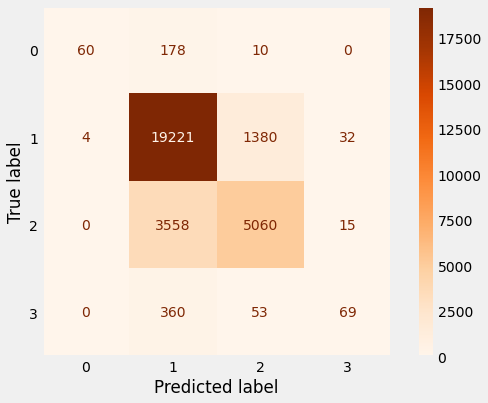


ROC AUC: 0.6745

Average Accuracy: 	 0.8122
Accuracy SD: 		 0.0064
Train Result:

Accuracy score: 0.8183

Error rate: 0.1817

recall of the positive class is also known as sensitivity ; recall of the negative class is specificity
Classification Report: 
               precision    recall  f1-score   support

           0       0.90      0.27      0.42       544
           1       0.83      0.93      0.88     48496
           2       0.78      0.59      0.67     19800
           3       0.67      0.19      0.30      1160

    accuracy                           0.82     70000
   macro avg       0.80      0.50      0.57     70000
weighted avg       0.81      0.82      0.81     70000


Confusion Matrix: 
 [[  147   368    28     1]
 [   10 45300  3120    66]
 [    2  8146 11610    42]
 [    4   812   122   222]]



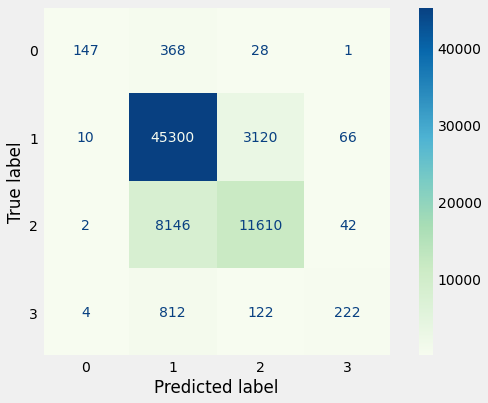


ROC AUC: 0.6852

Average Accuracy: 	 0.8154
Accuracy SD: 		 0.0021


In [ ]:
xgb_classifier = classify(xgb.XGBClassifier)


Logistic Classification 

Test Result:

Accuracy score: 0.6868

Error rate: 0.3132

recall of the positive class is also known as sensitivity ; recall of the negative class is specificity
Classification Report: 
               precision    recall  f1-score   support

           0       0.22      0.01      0.02       248
           1       0.69      0.99      0.81     20637
           2       0.39      0.01      0.02      8633
           3       0.33      0.00      0.00       482

    accuracy                           0.69     30000
   macro avg       0.41      0.25      0.21     30000
weighted avg       0.59      0.69      0.57     30000


Confusion Matrix: 
 [[    2   246     0     0]
 [    4 20518   113     2]
 [    3  8546    84     0]
 [    0   464    17     1]]



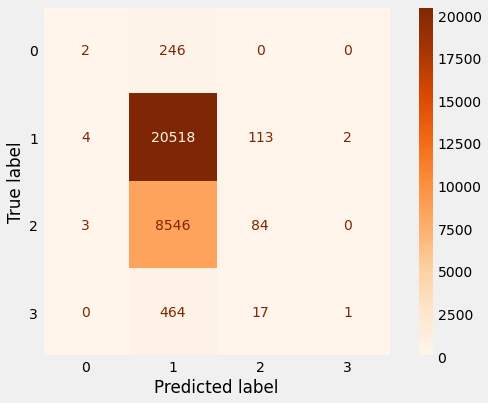


ROC AUC: 0.5024

Average Accuracy: 	 0.6865
Accuracy SD: 		 0.0015
Train Result:

Accuracy score: 0.6910

Error rate: 0.3090

recall of the positive class is also known as sensitivity ; recall of the negative class is specificity
Classification Report: 
               precision    recall  f1-score   support

           0       0.18      0.00      0.01       544
           1       0.69      0.99      0.82     48496
           2       0.35      0.01      0.02     19800
           3       0.00      0.00      0.00      1160

    accuracy                           0.69     70000
   macro avg       0.31      0.25      0.21     70000
weighted avg       0.58      0.69      0.57     70000


Confusion Matrix: 
 [[    2   542     0     0]
 [    8 48188   300     0]
 [    1 19617   181     1]
 [    0  1118    42     0]]



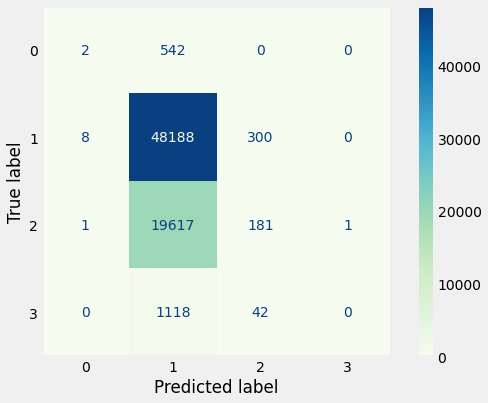


ROC AUC: 0.5013

Average Accuracy: 	 0.6909
Accuracy SD: 		 0.0008


In [ ]:
log_classifier = LogisticRegression(max_iter=100000, n_jobs = -1)

log_classifier.fit(X_train, y_train)

print_performance(log_classifier, X_train, X_test, y_train, y_test, train=False)
print("=" * 40)
print_performance(log_classifier, X_train, X_test, y_train, y_test, train=True)

*Classification By Stacking Methods*

**Stacking With Random Forest, Desicion Tree and Logistic Classification**

In [ ]:
sclf = StackingClassifier(classifiers=[xgb_classifier, gradient_classifier, ada_classifier], meta_classifier=bag_classifier)

sclf.fit(X_train, y_train)

print_performance(sclf, X_train, X_test, y_train, y_test, train=False)
print("=" * 40)
print_performance(sclf, X_train, X_test, y_train, y_test, train=True)

Test Result:

Accuracy score: 0.7744

Error rate: 0.2256

recall of the positive class is also known as sensitivity ; recall of the negative class is specificity
Classification Report: 
               precision    recall  f1-score   support

           0       0.42      0.43      0.42       248
           1       0.85      0.84      0.84     20637
           2       0.65      0.66      0.66      8633
           3       0.23      0.24      0.24       482

    accuracy                           0.77     30000
   macro avg       0.54      0.54      0.54     30000
weighted avg       0.78      0.77      0.78     30000


Confusion Matrix: 
 [[  106   110    25     7]
 [  118 17291  2949   279]
 [   23  2797  5720    93]
 [    6   240   121   115]]

ROC AUC: 0.7085

Average Accuracy: 	 0.7565
Accuracy SD: 		 0.0053
Train Result:

Accuracy score: 1.0000

Error rate: 0.0000

recall of the positive class is also known as sensitivity ; recall of the negative class is specificity
Classification Re

# **Clustering**

**Checking for cluster tendency with Hopkins Score**

A score between 0 and 1, a score around 0.5 express no clusterability and a score tending to 0 express a high cluster tendency.

In [ ]:
hopkins(X,  X.shape[0])

0.22007170335550175

Defining function to find optimal number of clusters

In [ ]:
mms = MinMaxScaler()
mms.fit(X)
data_transformed = mms.transform(X)

def find_optimal_clusters(model):
  Sum_of_squared_distances = []
  K = range(1,15)

  for k in K:
      km = model(n_clusters=k, n_jobs = -1)
      km = km.fit(data_transformed)
      Sum_of_squared_distances.append(km.inertia_)

  plt.plot(K, Sum_of_squared_distances, 'bx-')
  plt.xlabel('k')
  plt.ylabel('Sum of squared distances')
  plt.title('Elbow Method For Optimal k')

  kn = KneeLocator(range(1,15), Sum_of_squared_distances, curve='convex', direction='decreasing')
  plt.vlines(kn.knee, plt.ylim()[0], plt.ylim()[1], linestyles='dashed')

  plt.show()

  return kn.knee

Defining function to cluster

In [ ]:
def cluster(model):
  model = model(random_state = 40, n_jobs = -1, n_clusters = find_optimal_clusters(model))

  model.fit(X)

  print_clusters_performance(model)

  return model


Defining clustering performance function

In [ ]:
def print_clusters_performance(model):
  res = model.predict(X)  

  print("Adjusted Rand Score : {0:4f}\n".format(metrics.adjusted_rand_score(y, res))) 
  print("Adjusted Mutual Information : {0:4f}\n".format(metrics.adjusted_mutual_info_score(y, res)))  
  print("Homogeneity Score : {0:4f}\n".format(metrics.homogeneity_score(y, res))) 
  print("Completeness Score : {0:4f}\n".format(metrics.completeness_score(y, res))) 
  print("V Measure Score : {0:4f}\n".format(metrics.v_measure_score(y, res))) 
  print("Fowlkes Mallows Score : {0:4f}\n".format(metrics.fowlkes_mallows_score(y, res))) 
  print("Contingency Matrix : {}\n".format(metrics.cluster.contingency_matrix(y, res))) 

  print("Silhouette Score : {0:4f}\n".format(metrics.silhouette_score(X, res)))
  print("Harabasz Score : {0:4f}\n".format(metrics.calinski_harabasz_score(X, res)))  
  print("Davies Bouldin Score : {0:4f}\n".format(metrics.davies_bouldin_score(X, res))) 

**K Means**

In [ ]:
kmeans = cluster(KMeans)

**DB Scan**

In [ ]:
from sklearn.cluster import DBSCAN

db = DBSCAN()

db.fit(X)

DBSCAN(algorithm='auto', eps=0.5, leaf_size=30, metric='euclidean',
       metric_params=None, min_samples=5, n_jobs=None, p=None)

In [ ]:
metrics.v_measure_score(y, db.labels_)

4.770333183966581e-15

In [ ]:
metrics.adjusted_rand_score(y, db.labels_)

0.0

In [ ]:
metrics.cluster.contingency_matrix(y, db.labels_)

**-----------------------------------------------**